In [1]:
#importings
import pandas as pd
import numpy as np
# from sklearn.
from math import radians, cos, sin, asin, sqrt
import plotly.express as px
import geopy.distance
from sklearn.linear_model import LinearRegression,Ridge,Lasso
import seaborn as sns
from datasist.structdata import detect_outliers
from category_encoders import OneHotEncoder, BinaryEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error
from sklearn.preprocessing import MinMaxScaler
import matplotlib.pyplot as plt

## loading data

In [2]:
df = pd.read_csv('uber.csv')
#split the DataFrame into chunks where each chunk has 3 rows


In [3]:
df.drop(columns = 'Unnamed: 0',inplace= True)
df.reset_index(drop= True, inplace = True)

In [4]:
df.head()

,key,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count
0,2015-05-07 19:52:06.0000003,7.5,2015-05-07 19:52:06 UTC,-73.999817,40.738354,-73.999512,40.723217,1
1,2009-07-17 20:04:56.0000002,7.7,2009-07-17 20:04:56 UTC,-73.994355,40.728225,-73.994710,40.750325,1
2,2009-08-24 21:45:00.00000061,12.9,2009-08-24 21:45:00 UTC,-74.005043,40.740770,-73.962565,40.772647,1
3,2009-06-26 08:22:21.0000001,5.3,2009-06-26 08:22:21 UTC,-73.976124,40.790844,-73.965316,40.803349,3
4,2014-08-28 17:47:00.000000188,16.0,2014-08-28 17:47:00 UTC,-73.925023,40.744085,-73.973082,40.761247,5


In [5]:
df.isna().sum()

key                  0
fare_amount          0
pickup_datetime      0
pickup_longitude     0
pickup_latitude      0
dropoff_longitude    1
dropoff_latitude     1
passenger_count      0
dtype: int64

In [6]:
df.dropna(inplace= True)

## Calculate the distance between the pickup and drop co-ordinates using the Haversine formual for accuracy
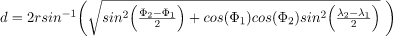

In [7]:
def haversine(sere):
    """
    Calculate the great circle distance in kilometers between two points 
    on the earth (specified in decimal degrees)
    """
    # convert decimal degrees to radians 
#     print(sere)
    lat1 = sere['pickup_latitude']
    lon1 = sere['pickup_longitude']
    lon2 = sere['dropoff_longitude']
    lat2 = sere['dropoff_latitude']
    lon1, lat1, lon2, lat2 = map(radians, [lon1, lat1, lon2, lat2])

    # haversine formula 
    dlon = lon2 - lon1 
    dlat = lat2 - lat1 
    a = sin(dlat/2)**2 + cos(lat1) * cos(lat2) * sin(dlon/2)**2
    c = 2 * asin(sqrt(a)) 
    r = 6371 # Radius of earth in kilometers. Use 3956 for miles. Determines return value units.
    return pd.Series(round(c * r,3))

In [8]:
df['destance_km']= df.apply(haversine,axis=1)

In [9]:
df

,key,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,destance_km
0,2015-05-07 19:52:06.0000003,7.5,2015-05-07 19:52:06 UTC,-73.999817,40.738354,-73.999512,40.723217,1,1.683
1,2009-07-17 20:04:56.0000002,7.7,2009-07-17 20:04:56 UTC,-73.994355,40.728225,-73.994710,40.750325,1,2.458
2,2009-08-24 21:45:00.00000061,12.9,2009-08-24 21:45:00 UTC,-74.005043,40.740770,-73.962565,40.772647,1,5.036
3,2009-06-26 08:22:21.0000001,5.3,2009-06-26 08:22:21 UTC,-73.976124,40.790844,-73.965316,40.803349,3,1.662
4,2014-08-28 17:47:00.000000188,16.0,2014-08-28 17:47:00 UTC,-73.925023,40.744085,-73.973082,40.761247,5,4.475
...,...,...,...,...,...,...,...,...,...
199995,2012-10-28 10:49:00.00000053,3.0,2012-10-28 10:49:00 UTC,-73.987042,40.739367,-73.986525,40.740297,1,0.112
199996,2014-03-14 01:09:00.0000008,7.5,2014-03-14 01:09:00 UTC,-73.984722,40.736837,-74.006672,40.739620,1,1.875
199997,2009-06-29 00:42:00.00000078,30.9,2009-06-29 00:42:00 UTC,-73.986017,40.756487,-73.858957,40.692588,2,12.850
199998,2015-05-20 14:56:25.0000004,14.5,2015-05-20 14:56:25 UTC,-73.997124,40.725452,-73.983215,40.695415,1,3.540


In [10]:
df = df[(df.pickup_latitude<90) & (df.dropoff_latitude<90) &
        (df.pickup_latitude>-90) & (df.dropoff_latitude>-90) &
        (df.pickup_longitude<180) & (df.dropoff_longitude<180) &
        (df.pickup_longitude>-180) & (df.dropoff_longitude>-180)]
# df['Distance']=[round(geopy.distance.distance((df.pickup_latitude[i], df.pickup_longitude[i]),(df.dropoff_latitude[i], df.dropoff_longitude[i])).m,2) for i in df.index]

In [11]:
df

,key,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,destance_km
0,2015-05-07 19:52:06.0000003,7.5,2015-05-07 19:52:06 UTC,-73.999817,40.738354,-73.999512,40.723217,1,1.683
1,2009-07-17 20:04:56.0000002,7.7,2009-07-17 20:04:56 UTC,-73.994355,40.728225,-73.994710,40.750325,1,2.458
2,2009-08-24 21:45:00.00000061,12.9,2009-08-24 21:45:00 UTC,-74.005043,40.740770,-73.962565,40.772647,1,5.036
3,2009-06-26 08:22:21.0000001,5.3,2009-06-26 08:22:21 UTC,-73.976124,40.790844,-73.965316,40.803349,3,1.662
4,2014-08-28 17:47:00.000000188,16.0,2014-08-28 17:47:00 UTC,-73.925023,40.744085,-73.973082,40.761247,5,4.475
...,...,...,...,...,...,...,...,...,...
199995,2012-10-28 10:49:00.00000053,3.0,2012-10-28 10:49:00 UTC,-73.987042,40.739367,-73.986525,40.740297,1,0.112
199996,2014-03-14 01:09:00.0000008,7.5,2014-03-14 01:09:00 UTC,-73.984722,40.736837,-74.006672,40.739620,1,1.875
199997,2009-06-29 00:42:00.00000078,30.9,2009-06-29 00:42:00 UTC,-73.986017,40.756487,-73.858957,40.692588,2,12.850
199998,2015-05-20 14:56:25.0000004,14.5,2015-05-20 14:56:25 UTC,-73.997124,40.725452,-73.983215,40.695415,1,3.540


In [12]:
df.destance_km.max()

8782.899

In [13]:
#visualize distance vs fare
px.scatter(df,x= 'destance_km',y= 'fare_amount')

In [14]:
df.head()

,key,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,destance_km
0,2015-05-07 19:52:06.0000003,7.5,2015-05-07 19:52:06 UTC,-73.999817,40.738354,-73.999512,40.723217,1,1.683
1,2009-07-17 20:04:56.0000002,7.7,2009-07-17 20:04:56 UTC,-73.994355,40.728225,-73.994710,40.750325,1,2.458
2,2009-08-24 21:45:00.00000061,12.9,2009-08-24 21:45:00 UTC,-74.005043,40.740770,-73.962565,40.772647,1,5.036
3,2009-06-26 08:22:21.0000001,5.3,2009-06-26 08:22:21 UTC,-73.976124,40.790844,-73.965316,40.803349,3,1.662
4,2014-08-28 17:47:00.000000188,16.0,2014-08-28 17:47:00 UTC,-73.925023,40.744085,-73.973082,40.761247,5,4.475


In [15]:
# px.scatter(df,x= 'Distance',y= 'fare_amount')

In [18]:
# df.pickup_datetime.dt.weekday.unique()

In [19]:
df.pickup_datetime=pd.to_datetime(df.pickup_datetime)

df['year'] = df.pickup_datetime.dt.year
df['month'] = df.pickup_datetime.dt.month
df['day_name'] = df.pickup_datetime.dt.day_name()
df['hour'] = df.pickup_datetime.dt.hour
months = {12:'winter',1:'winter',2:'winter',3:'spring',4:'spring',5:'spring',6:'summer',7:'summer',
                                      8:'summer',9:'fall',10:'fall',11:'fall'}
years= {2015:'y_2015', 2009:'y_2009', 2012:'y_2012', 2011:'y_2011', 2010:'y_2010', 2014:'y_2014', 2013:'y_2013'}

df['Monthly_Quarter'] = df.month.map(months)
df['year'] = df.year.map(years)
df['Hourly_Segments'] = df.hour.map({0:'H1',1:'H1',2:'H1',3:'H1',4:'H2',5:'H2',6:'H2',7:'H2',8:'H3',
                                     9:'H3',10:'H3',11:'H3',12:'H4',13:'H4',14:'H4',15:'H4',16:'H5',
                                     17:'H5',18:'H5',19:'H5',20:'H6',21:'H6',22:'H6',23:'H6'})
df.drop(['pickup_datetime','month', 'hour'], axis=1, inplace=True)

original_df = df.copy(deep=True)

original_df.head()

C:\Users\Ahmed_Moataz\AppData\Local\Temp\ipykernel_11848\1739605389.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\Ahmed_Moataz\AppData\Local\Temp\ipykernel_11848\1739605389.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\Ahmed_Moataz\AppData\Local\Temp\ipykernel_11848\1739605389.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pa

,key,fare_amount,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,destance_km,year,day_name,Monthly_Quarter,Hourly_Segments
0,2015-05-07 19:52:06.0000003,7.5,-73.999817,40.738354,-73.999512,40.723217,1,1.683,y_2015,Thursday,spring,H5
1,2009-07-17 20:04:56.0000002,7.7,-73.994355,40.728225,-73.994710,40.750325,1,2.458,y_2009,Friday,summer,H6
2,2009-08-24 21:45:00.00000061,12.9,-74.005043,40.740770,-73.962565,40.772647,1,5.036,y_2009,Monday,summer,H6
3,2009-06-26 08:22:21.0000001,5.3,-73.976124,40.790844,-73.965316,40.803349,3,1.662,y_2009,Friday,summer,H3
4,2014-08-28 17:47:00.000000188,16.0,-73.925023,40.744085,-73.973082,40.761247,5,4.475,y_2014,Thursday,summer,H5


In [20]:
df.nunique().sort_values()

Monthly_Quarter           4
Hourly_Segments           6
year                      7
day_name                  7
passenger_count           8
fare_amount            1244
destance_km           16789
pickup_longitude      71055
dropoff_longitude     76890
pickup_latitude       83831
dropoff_latitude      90582
key                  199987
dtype: int64

## Detecting outlier

In [21]:
df.drop(df[df['destance_km'] == 0].index,inplace= True)

C:\Users\Ahmed_Moataz\AppData\Local\Temp\ipykernel_11848\133070088.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [22]:
px.scatter(df,x= 'destance_km',y= 'fare_amount')

## Handle outlier

In [23]:
df.drop_duplicates(inplace=True)
df.drop(['pickup_latitude','pickup_longitude',
         'dropoff_latitude','dropoff_longitude'],axis=1,inplace= True)

C:\Users\Ahmed_Moataz\AppData\Local\Temp\ipykernel_11848\688620796.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\Ahmed_Moataz\AppData\Local\Temp\ipykernel_11848\688620796.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [24]:
df_numerical= df.select_dtypes(exclude=['object'])


In [25]:
outliers_indices = detect_outliers(df_numerical, 0, df_numerical.columns)
len(outliers_indices)

39465

In [26]:
df.drop(outliers_indices, inplace=True)
df.reset_index(drop= True,inplace= True)

C:\Users\Ahmed_Moataz\AppData\Local\Temp\ipykernel_11848\1157615421.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [27]:
#now visualize distance vs fare again
px.scatter(df,x= 'destance_km',y= 'fare_amount')

In [28]:
df.drop(df[df['fare_amount'] <=0].index,inplace= True)

C:\Users\Ahmed_Moataz\AppData\Local\Temp\ipykernel_11848\1424272642.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [29]:
px.scatter(df,x= 'destance_km',y= 'fare_amount')

## Dealing with data column......Feature Engineering

In [30]:
df.nunique().sort_values()

passenger_count         4
Monthly_Quarter         4
Hourly_Segments         6
year                    7
day_name                7
fare_amount           224
destance_km          7862
key                154797
dtype: int64

In [31]:
# do some feature engineering
px.imshow(df.corr(),text_auto= True)

In [32]:
df.drop(columns= ['key'], inplace= True)

C:\Users\Ahmed_Moataz\AppData\Local\Temp\ipykernel_11848\1798814940.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [33]:
df.drop(columns= ['passenger_count'], inplace= True)

C:\Users\Ahmed_Moataz\AppData\Local\Temp\ipykernel_11848\3620753826.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



## Average Yearly Trips

## Average Monthly Trips

## Average Daily Trips

## Rides vs Time

In [34]:
# plot correlation matrix
px.imshow(df.corr(),text_auto= True)

In [35]:
# px.histogram(x=df['d'],y= df['fare_amount'])

In [36]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 154797 entries, 0 to 154803
Data columns (total 6 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   fare_amount      154797 non-null  float64
 1   destance_km      154797 non-null  float64
 2   year             154797 non-null  object 
 3   day_name         154797 non-null  object 
 4   Monthly_Quarter  154797 non-null  object 
 5   Hourly_Segments  154797 non-null  object 
dtypes: float64(2), object(4)
memory usage: 8.3+ MB


In [37]:
df_2 = df.copy(deep= True)

In [38]:
# df[['year','weekday']]= df[['year','weekday']].astype('object')

In [39]:
df['year'].unique()

array(['y_2015', 'y_2009', 'y_2012', 'y_2011', 'y_2010', 'y_2014',
       'y_2013'], dtype=object)

In [40]:
X= df.drop(columns= ['fare_amount'])
y= df['fare_amount']

In [41]:
ohe = OneHotEncoder()
ohe.fit(X[['year','day_name','Monthly_Quarter','Hourly_Segments']])
XT_train= ohe.transform(X[['year','day_name','Monthly_Quarter','Hourly_Segments']])

In [42]:
XT_train.shape

(154797, 24)

In [43]:
X.shape

(154797, 5)

## As we can see from the above heatmap there is a high corroletion between fare and distance

In [44]:
#split data to features and label
X_trans= pd.concat([X['destance_km'],XT_train],axis=1)

In [45]:
X_trans

,destance_km,year_1,year_2,year_3,year_4,year_5,year_6,year_7,day_name_1,day_name_2,...,Monthly_Quarter_1,Monthly_Quarter_2,Monthly_Quarter_3,Monthly_Quarter_4,Hourly_Segments_1,Hourly_Segments_2,Hourly_Segments_3,Hourly_Segments_4,Hourly_Segments_5,Hourly_Segments_6
0,1.683,1,0,0,0,0,0,0,1,0,...,1,0,0,0,1,0,0,0,0,0
1,2.458,0,1,0,0,0,0,0,0,1,...,0,1,0,0,0,1,0,0,0,0
2,5.036,0,1,0,0,0,0,0,0,0,...,0,1,0,0,0,1,0,0,0,0
3,1.662,0,1,0,0,0,0,0,0,1,...,0,1,0,0,0,0,1,0,0,0
4,2.333,0,0,1,0,0,0,0,0,1,...,0,0,1,0,0,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
154799,1.123,0,0,0,0,0,1,0,0,1,...,0,0,1,0,0,0,0,0,1,0
154800,0.112,0,0,1,0,0,0,0,0,0,...,0,0,0,1,0,0,1,0,0,0
154801,1.875,0,0,0,0,0,1,0,0,1,...,1,0,0,0,0,0,0,1,0,0
154802,3.540,1,0,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,1,0


In [46]:
#split data to train andd test
X_train, X_test, y_train, y_test = train_test_split(X_trans, y, test_size=0.3, random_state=42)

In [47]:
# do feature scaling


In [48]:
# build your regression model
model= LinearRegression()
model.fit(X_train,y_train)

LinearRegression()

In [49]:
#evaluate your model
model.score(X_test,y_test)

0.7149829616113373

In [50]:
model.score(X_train,y_train)

0.7175807065410145

In [51]:
pred_train= model.predict(X_train)

In [52]:
pred_test= model.predict(X_test)

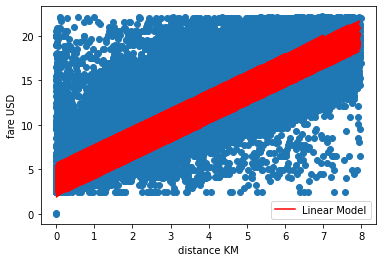

In [53]:
plt.plot(X_train['destance_km'],pred_train,color= 'r',label = 'Linear Model')
plt.scatter(x=X_train['destance_km'],y= y_train )
plt.xlabel("distance KM")
plt.ylabel("fare USD")
plt.legend();

### test_data

Text(0, 0.5, 'fare USD')

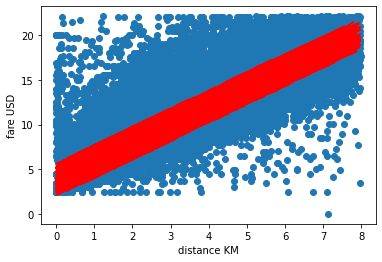

In [54]:
plt.plot(X_test['destance_km'],pred_test,color= 'r',label = 'Linear Model')
plt.scatter(x=X_test['destance_km'],y= y_test )
plt.xlabel("distance KM")
plt.ylabel("fare USD")

## Apply Ridge Reression

In [55]:
#train model
# build your regression model
model= Ridge()
model.fit(X_train,y_train)

Ridge()

In [56]:
model.score(X_test,y_test)

0.7149828506890639

In [57]:
model.score(X_train,y_train)

0.717580706255826

In [58]:
pred_train= model.predict(X_train)

pred_test= model.predict(X_test)

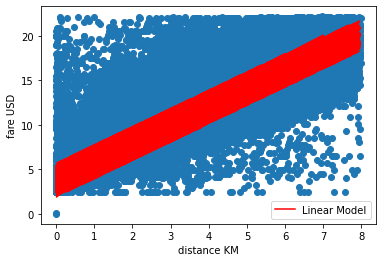

In [59]:
plt.plot(X_train['destance_km'],pred_train,color= 'r',label = 'Linear Model')
plt.scatter(x=X_train['destance_km'],y= y_train )
plt.xlabel("distance KM")
plt.ylabel("fare USD")
plt.legend();

Text(0, 0.5, 'fare USD')

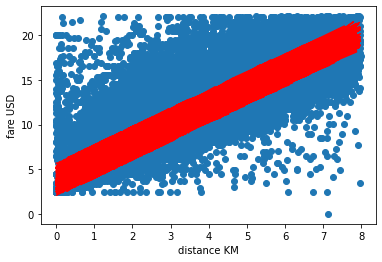

In [60]:
plt.plot(X_test['destance_km'],pred_test,color= 'r',label = 'Linear Model')
plt.scatter(x=X_test['destance_km'],y= y_test )
plt.xlabel("distance KM")
plt.ylabel("fare USD")

In [ ]:
#evaluate the model


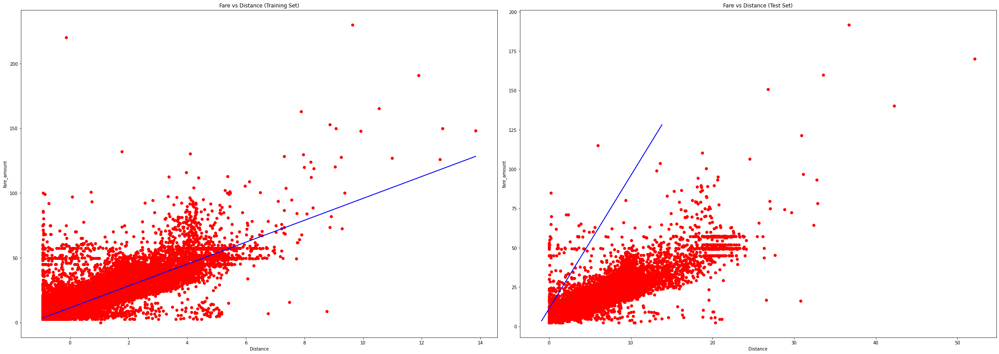

## Apply lasso Regression

In [61]:
#train model
model= Lasso()
model.fit(X_train,y_train)

Lasso()

In [62]:
#evaluate the model
model.score(X_test,y_test)

0.6440573381257104

In [63]:
model.score(X_train,y_train)

0.6467601846558069

In [64]:
pred_train= model.predict(X_train)

pred_test= model.predict(X_test)

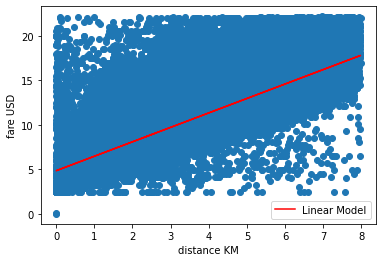

In [65]:
plt.plot(X_train['destance_km'],pred_train,color= 'r',label = 'Linear Model')
plt.scatter(x=X_train['destance_km'],y= y_train )
plt.xlabel("distance KM")
plt.ylabel("fare USD")
plt.legend();

Text(0, 0.5, 'fare USD')

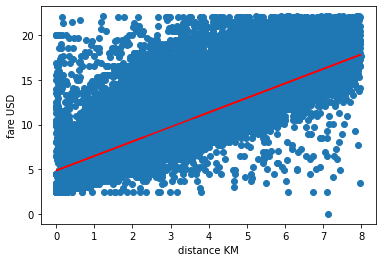

In [66]:
plt.plot(X_test['destance_km'],pred_test,color= 'r',label = 'Linear Model')
plt.scatter(x=X_test['destance_km'],y= y_test )
plt.xlabel("distance KM")
plt.ylabel("fare USD")

In [67]:
model.coef_

array([ 1.62228681,  0.        , -0.        , -0.        , -0.        ,
       -0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
       -0.        , -0.        , -0.        ,  0.        , -0.        ,
       -0.        , -0.        , -0.        ,  0.        ,  0.        ,
       -0.        ,  0.        , -0.        ,  0.        , -0.        ])

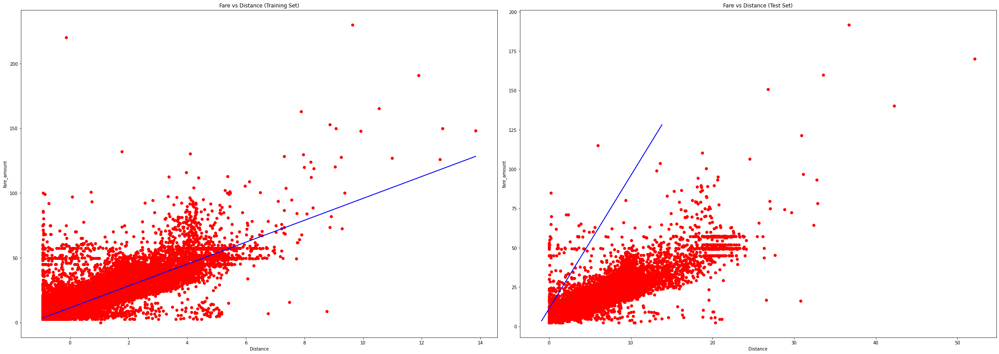